<a href="https://colab.research.google.com/github/masakapallibhuvan/DAI-101/blob/main/Assignment1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [127]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn.model_selection import GridSearchCV
import os
import seaborn as sns
from scipy import stats


In [83]:
df = pd.read_csv('StudentPerformanceFactors.csv')

#**Univariate Analysis**

In [84]:
df.shape

(6607, 20)

In [85]:
df.head()

,Hours_Studied,Attendance,Parental_Involvement,Access_to_Resources,Extracurricular_Activities,Sleep_Hours,Previous_Scores,Motivation_Level,Internet_Access,Tutoring_Sessions,Family_Income,Teacher_Quality,School_Type,Peer_Influence,Physical_Activity,Learning_Disabilities,Parental_Education_Level,Distance_from_Home,Gender,Exam_Score
0,23,84,Low,High,No,7,73,Low,Yes,0,Low,Medium,Public,Positive,3,No,High School,Near,Male,67
1,19,64,Low,Medium,No,8,59,Low,Yes,2,Medium,Medium,Public,Negative,4,No,College,Moderate,Female,61
2,24,98,Medium,Medium,Yes,7,91,Medium,Yes,2,Medium,Medium,Public,Neutral,4,No,Postgraduate,Near,Male,74
3,29,89,Low,Medium,Yes,8,98,Medium,Yes,1,Medium,Medium,Public,Negative,4,No,High School,Moderate,Male,71
4,19,92,Medium,Medium,Yes,6,65,Medium,Yes,3,Medium,High,Public,Neutral,4,No,College,Near,Female,70


In [86]:
df.tail()

,Hours_Studied,Attendance,Parental_Involvement,Access_to_Resources,Extracurricular_Activities,Sleep_Hours,Previous_Scores,Motivation_Level,Internet_Access,Tutoring_Sessions,Family_Income,Teacher_Quality,School_Type,Peer_Influence,Physical_Activity,Learning_Disabilities,Parental_Education_Level,Distance_from_Home,Gender,Exam_Score
6602,25,69,High,Medium,No,7,76,Medium,Yes,1,High,Medium,Public,Positive,2,No,High School,Near,Female,68
6603,23,76,High,Medium,No,8,81,Medium,Yes,3,Low,High,Public,Positive,2,No,High School,Near,Female,69
6604,20,90,Medium,Low,Yes,6,65,Low,Yes,3,Low,Medium,Public,Negative,2,No,Postgraduate,Near,Female,68
6605,10,86,High,High,Yes,6,91,High,Yes,2,Low,Medium,Private,Positive,3,No,High School,Far,Female,68
6606,15,67,Medium,Low,Yes,9,94,Medium,Yes,0,Medium,Medium,Public,Positive,4,No,Postgraduate,Near,Male,64


In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6607 entries, 0 to 6606
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   Hours_Studied               6607 non-null   int64 
 1   Attendance                  6607 non-null   int64 
 2   Parental_Involvement        6607 non-null   object
 3   Access_to_Resources         6607 non-null   object
 4   Extracurricular_Activities  6607 non-null   object
 5   Sleep_Hours                 6607 non-null   int64 
 6   Previous_Scores             6607 non-null   int64 
 7   Motivation_Level            6607 non-null   object
 8   Internet_Access             6607 non-null   object
 9   Tutoring_Sessions           6607 non-null   int64 
 10  Family_Income               6607 non-null   object
 11  Teacher_Quality             6529 non-null   object
 12  School_Type                 6607 non-null   object
 13  Peer_Influence              6607 non-null   obje

In [88]:
df.describe()

,Hours_Studied,Attendance,Sleep_Hours,Previous_Scores,Tutoring_Sessions,Physical_Activity,Exam_Score
count,6607.000000,6607.000000,6607.00000,6607.000000,6607.000000,6607.000000,6607.000000
mean,19.975329,79.977448,7.02906,75.070531,1.493719,2.967610,67.235659
std,5.990594,11.547475,1.46812,14.399784,1.230570,1.031231,3.890456
min,1.000000,60.000000,4.00000,50.000000,0.000000,0.000000,55.000000
25%,16.000000,70.000000,6.00000,63.000000,1.000000,2.000000,65.000000
50%,20.000000,80.000000,7.00000,75.000000,1.000000,3.000000,67.000000
75%,24.000000,90.000000,8.00000,88.000000,2.000000,4.000000,69.000000
max,44.000000,100.000000,10.00000,100.000000,8.000000,6.000000,101.000000


Dividing the columns into categorical and numerical data types.

In [89]:
cat=[]
num=[]
for column in df.columns:
    if df[column].nunique()>5:
        num.append(column)
    else:
        cat.append(column)

In [90]:
cat

['Parental_Involvement',
 'Access_to_Resources',
 'Extracurricular_Activities',
 'Motivation_Level',
 'Internet_Access',
 'Family_Income',
 'Teacher_Quality',
 'School_Type',
 'Peer_Influence',
 'Learning_Disabilities',
 'Parental_Education_Level',
 'Distance_from_Home',
 'Gender']

In [91]:
num

['Hours_Studied',
 'Attendance',
 'Sleep_Hours',
 'Previous_Scores',
 'Tutoring_Sessions',
 'Physical_Activity',
 'Exam_Score']

 #  **Categorical**

In [92]:
cat

['Parental_Involvement',
 'Access_to_Resources',
 'Extracurricular_Activities',
 'Motivation_Level',
 'Internet_Access',
 'Family_Income',
 'Teacher_Quality',
 'School_Type',
 'Peer_Influence',
 'Learning_Disabilities',
 'Parental_Education_Level',
 'Distance_from_Home',
 'Gender']

In [93]:
for column in cat:
    print(f"Value counts for column '{column}':")
    valcoun_cat=df[column].value_counts()
    print(valcoun_cat)
    print()

Value counts for column 'Parental_Involvement':
Parental_Involvement
Medium    3362
High      1908
Low       1337
Name: count, dtype: int64

Value counts for column 'Access_to_Resources':
Access_to_Resources
Medium    3319
High      1975
Low       1313
Name: count, dtype: int64

Value counts for column 'Extracurricular_Activities':
Extracurricular_Activities
Yes    3938
No     2669
Name: count, dtype: int64

Value counts for column 'Motivation_Level':
Motivation_Level
Medium    3351
Low       1937
High      1319
Name: count, dtype: int64

Value counts for column 'Internet_Access':
Internet_Access
Yes    6108
No      499
Name: count, dtype: int64

Value counts for column 'Family_Income':
Family_Income
Low       2672
Medium    2666
High      1269
Name: count, dtype: int64

Value counts for column 'Teacher_Quality':
Teacher_Quality
Medium    3925
High      1947
Low        657
Name: count, dtype: int64

Value counts for column 'School_Type':
School_Type
Public     4598
Private    2009
Name

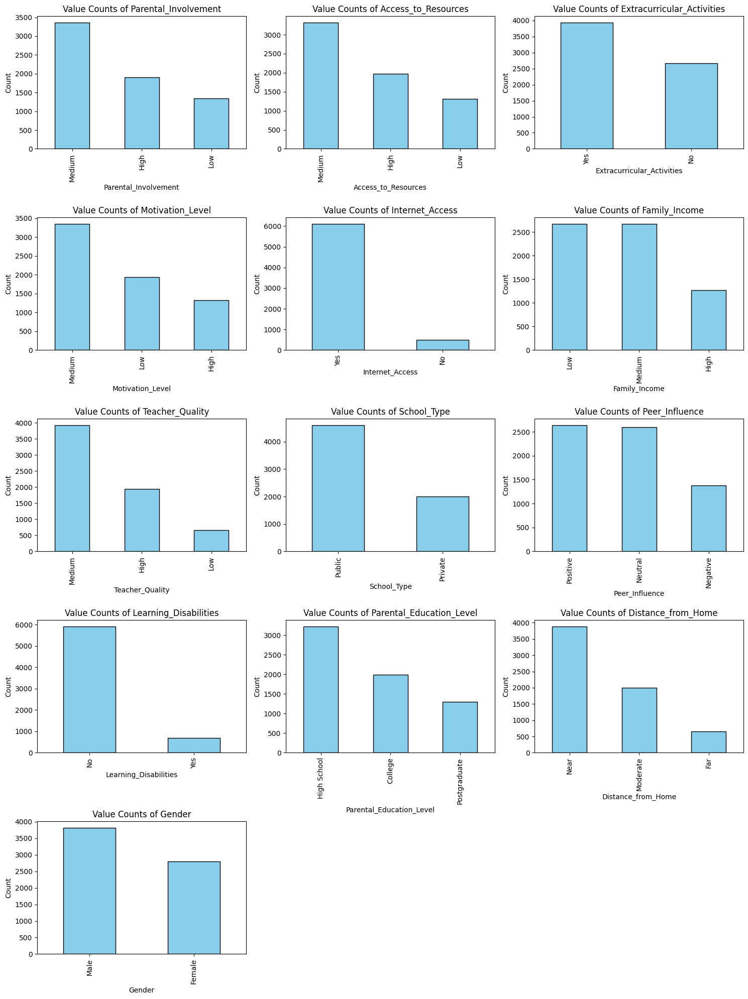

In [94]:
categorical_cols = ['Parental_Involvement', 'Access_to_Resources', 'Extracurricular_Activities',
                    'Motivation_Level', 'Internet_Access', 'Family_Income', 'Teacher_Quality',
                    'School_Type', 'Peer_Influence', 'Learning_Disabilities', 'Parental_Education_Level',
                    'Distance_from_Home', 'Gender']

plt.figure(figsize=(15, 20))
for i, col in enumerate(categorical_cols):
    plt.subplot(5, 3, i + 1)
    df[col].value_counts().plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title(f"Value Counts of {col}")
    plt.xlabel(col)
    plt.ylabel('Count')

plt.tight_layout()
plt.show()

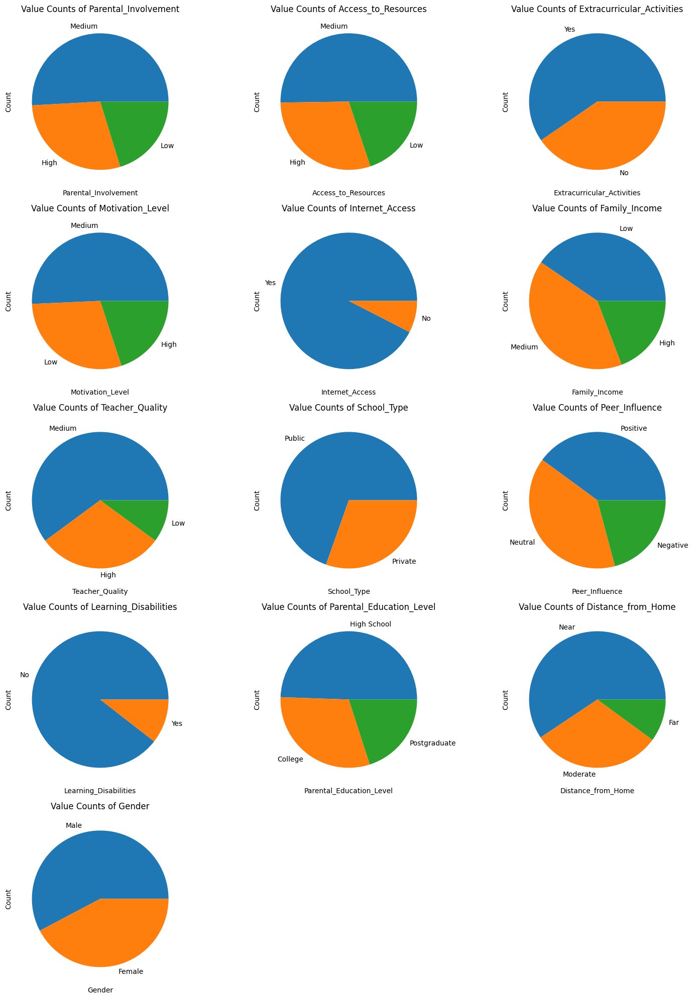

In [95]:
categorical_cols = ['Parental_Involvement', 'Access_to_Resources', 'Extracurricular_Activities',
                    'Motivation_Level', 'Internet_Access', 'Family_Income', 'Teacher_Quality',
                    'School_Type', 'Peer_Influence', 'Learning_Disabilities', 'Parental_Education_Level',
                    'Distance_from_Home', 'Gender']

plt.figure(figsize=(15, 20))
for i, col in enumerate(categorical_cols):
    plt.subplot(5, 3, i + 1)
    df[col].value_counts().plot(kind='pie')
    plt.title(f"Value Counts of {col}")
    plt.xlabel(col)
    plt.ylabel('Count')

plt.tight_layout()
plt.show()

In [96]:
for column in cat:
    # Get the value counts for the current column
    value_counts = df[column].value_counts()
    # Get counts and percentages
    value_percent = df[column].value_counts(normalize=True) * 100  # Normalize to get percentages

    # Combine both count and percentage into a single DataFrame
    result = pd.DataFrame({'Count': value_counts, 'count%': value_percent})

    # Display the result
    print(result)

                      Count     count%
Parental_Involvement                  
Medium                 3362  50.885425
High                   1908  28.878462
Low                    1337  20.236113
                     Count     count%
Access_to_Resources                  
Medium                3319  50.234600
High                  1975  29.892538
Low                   1313  19.872862
                            Count     count%
Extracurricular_Activities                  
Yes                          3938  59.603451
No                           2669  40.396549
                  Count     count%
Motivation_Level                  
Medium             3351  50.718934
Low                1937  29.317391
High               1319  19.963675
                 Count     count%
Internet_Access                  
Yes               6108  92.447404
No                 499   7.552596
               Count     count%
Family_Income                  
Low             2672  40.441956
Medium          2666  40.351

# **Numerical**

In [97]:
num

['Hours_Studied',
 'Attendance',
 'Sleep_Hours',
 'Previous_Scores',
 'Tutoring_Sessions',
 'Physical_Activity',
 'Exam_Score']

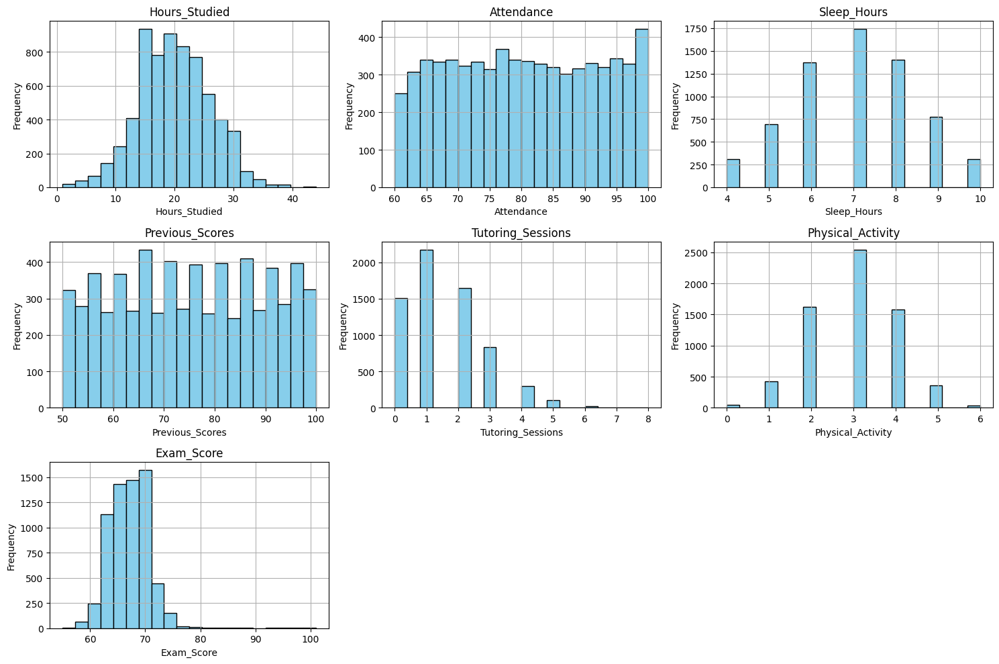

In [98]:
numerical_cols = ['Hours_Studied', 'Attendance', 'Sleep_Hours', 'Previous_Scores',
                  'Tutoring_Sessions', 'Physical_Activity', 'Exam_Score']

plt.figure(figsize=(15, 10))
for i, col in enumerate(numerical_cols):
    plt.subplot(3, 3, i + 1)
    df[col].hist(bins=20, color='skyblue', edgecolor='black')
    plt.title(col)
    plt.xlabel(col)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

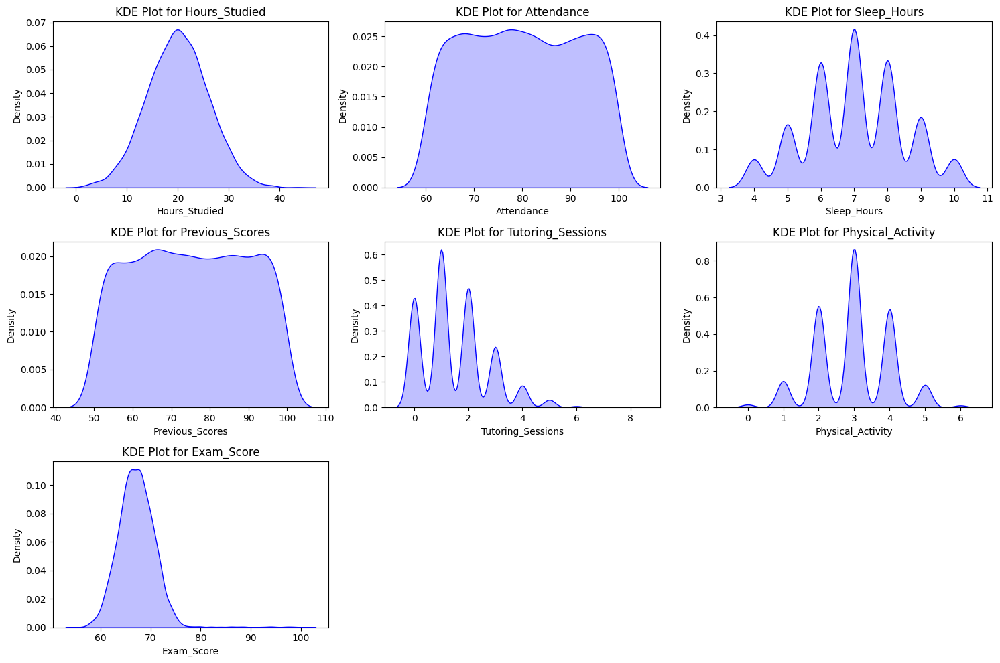

In [99]:
# Plotting KDE for each numerical variable
plt.figure(figsize=(15, 10))
for i, col in enumerate(numerical_cols):
    plt.subplot(3, 3, i + 1)
    sns.kdeplot(df[col], fill=True, color="blue")  # Updated to 'fill=True'
    plt.title(f'KDE Plot for {col}')
    plt.xlabel(col)
    plt.ylabel('Density')

plt.tight_layout()
plt.show()

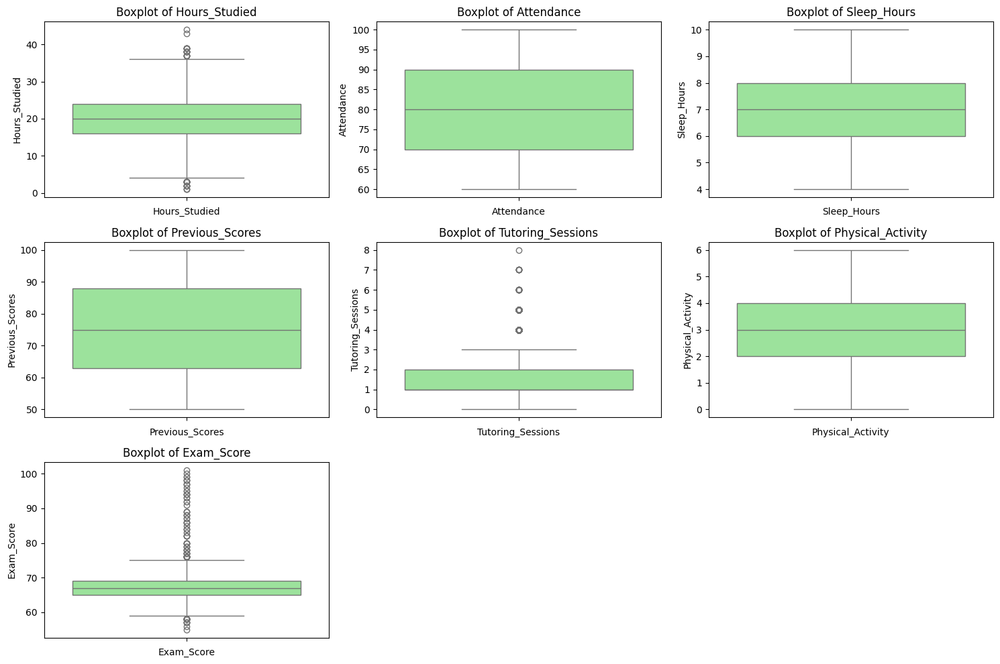

In [100]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(numerical_cols):
    plt.subplot(3, 3, i + 1)
    sns.boxplot(df[col], color='lightgreen')
    plt.title(f"Boxplot of {col}")
    plt.xlabel(col)

plt.tight_layout()
plt.show()

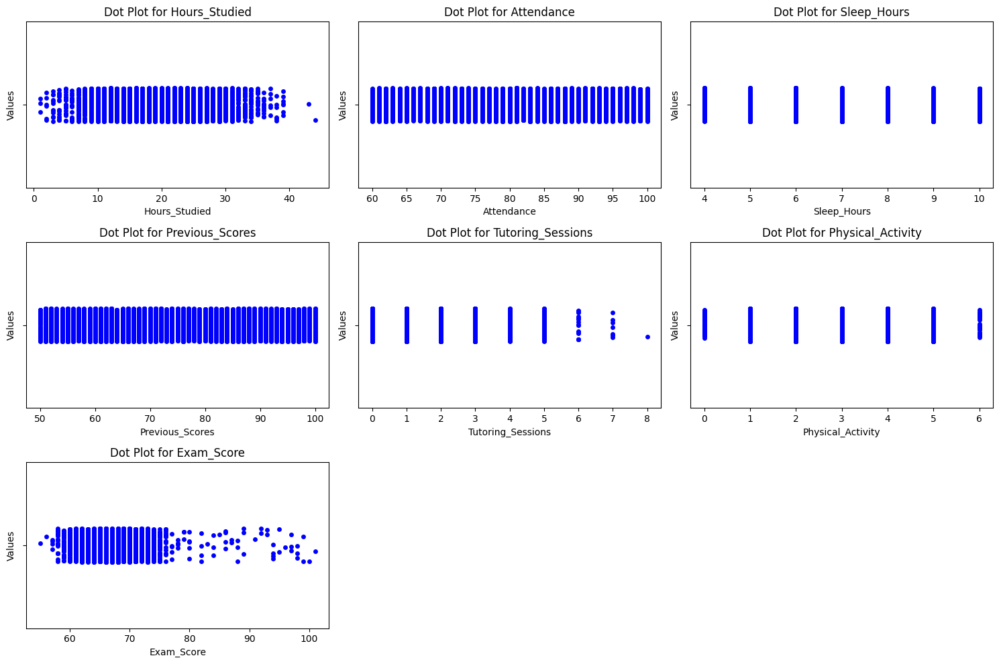

In [101]:
# Create dot plots for each numerical variable
plt.figure(figsize=(15, 10))
for i, col in enumerate(numerical_cols):
    plt.subplot(3, 3, i + 1)
    sns.stripplot(data=df, x=col, color="blue", jitter=True)
    plt.title(f'Dot Plot for {col}')
    plt.xlabel(col)
    plt.ylabel('Values')

plt.tight_layout()
plt.show()

In [102]:
# Function to calculate and print key statistics for each numerical column
def calculate_statistics(df, col):
    print(f"Statistics for {col}:")
    print(f"Mean: {df[col].mean()}")
    print(f"Median: {df[col].median()}")
    print(f"Mode: {df[col].mode()[0]}")
    print(f"Variance: {df[col].var()}")
    print(f"Standard Deviation: {df[col].std()}")
    print(f"Skewness: {df[col].skew()}")

    print("                                                  "'\n')
# Loop through numerical columns and display statistics
for col in numerical_cols:
  calculate_statistics(df, col)

Statistics for Hours_Studied:
Mean: 19.975329196306948
Median: 20.0
Mode: 20
Variance: 35.887220505449555
Standard Deviation: 5.990594336578764
Skewness: 0.013498908859762987
                                                  

Statistics for Attendance:
Mean: 79.97744816104132
Median: 80.0
Mode: 67
Variance: 133.34417798607222
Standard Deviation: 11.547474961482802
Skewness: 0.013665859547014896
                                                  

Statistics for Sleep_Hours:
Mean: 7.029060087785682
Median: 7.0
Mode: 7
Variance: 2.1553770001733086
Standard Deviation: 1.4681202267434736
Skewness: -0.023805436886157025
                                                  

Statistics for Previous_Scores:
Mean: 75.07053125472983
Median: 75.0
Mode: 66
Variance: 207.35378934836308
Standard Deviation: 14.399784350758976
Skewness: -0.00373653379826588
                                                  

Statistics for Tutoring_Sessions:
Mean: 1.4937187831088239
Median: 1.0
Mode: 1
Variance: 1.51430

#**Multivariate Analysis**

In [103]:
from pydoc import help # can type in the python console `help(name of function)` to get the documentation
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import scale
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from scipy import stats
from IPython.display import display, HTML
# figures inline in notebook
%matplotlib inline
np.set_printoptions(suppress=True)
pd.set_option('display.max_rows', 20)
import os


In [104]:
data=pd.read_csv("StudentPerformanceFactors.csv")
data.columns = ["V"+str(i) for i in range(1, len(data.columns)+1)]
X = data.loc[:, "V2":] # independent variables data
y = data.V1 # dependednt variable data
data

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20
0,23,84,Low,High,No,7,73,Low,Yes,0,Low,Medium,Public,Positive,3,No,High School,Near,Male,67
1,19,64,Low,Medium,No,8,59,Low,Yes,2,Medium,Medium,Public,Negative,4,No,College,Moderate,Female,61
2,24,98,Medium,Medium,Yes,7,91,Medium,Yes,2,Medium,Medium,Public,Neutral,4,No,Postgraduate,Near,Male,74
3,29,89,Low,Medium,Yes,8,98,Medium,Yes,1,Medium,Medium,Public,Negative,4,No,High School,Moderate,Male,71
4,19,92,Medium,Medium,Yes,6,65,Medium,Yes,3,Medium,High,Public,Neutral,4,No,College,Near,Female,70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6602,25,69,High,Medium,No,7,76,Medium,Yes,1,High,Medium,Public,Positive,2,No,High School,Near,Female,68
6603,23,76,High,Medium,No,8,81,Medium,Yes,3,Low,High,Public,Positive,2,No,High School,Near,Female,69
6604,20,90,Medium,Low,Yes,6,65,Low,Yes,3,Low,Medium,Public,Negative,2,No,Postgraduate,Near,Female,68
6605,10,86,High,High,Yes,6,91,High,Yes,2,Low,Medium,Private,Positive,3,No,High School,Far,Female,68


In [105]:
data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20
0,23,84,Low,High,No,7,73,Low,Yes,0,Low,Medium,Public,Positive,3,No,High School,Near,Male,67
1,19,64,Low,Medium,No,8,59,Low,Yes,2,Medium,Medium,Public,Negative,4,No,College,Moderate,Female,61
2,24,98,Medium,Medium,Yes,7,91,Medium,Yes,2,Medium,Medium,Public,Neutral,4,No,Postgraduate,Near,Male,74
3,29,89,Low,Medium,Yes,8,98,Medium,Yes,1,Medium,Medium,Public,Negative,4,No,High School,Moderate,Male,71
4,19,92,Medium,Medium,Yes,6,65,Medium,Yes,3,Medium,High,Public,Neutral,4,No,College,Near,Female,70


In [106]:
data.tail()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20
6602,25,69,High,Medium,No,7,76,Medium,Yes,1,High,Medium,Public,Positive,2,No,High School,Near,Female,68
6603,23,76,High,Medium,No,8,81,Medium,Yes,3,Low,High,Public,Positive,2,No,High School,Near,Female,69
6604,20,90,Medium,Low,Yes,6,65,Low,Yes,3,Low,Medium,Public,Negative,2,No,Postgraduate,Near,Female,68
6605,10,86,High,High,Yes,6,91,High,Yes,2,Low,Medium,Private,Positive,3,No,High School,Far,Female,68
6606,15,67,Medium,Low,Yes,9,94,Medium,Yes,0,Medium,Medium,Public,Positive,4,No,Postgraduate,Near,Male,64


In [107]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6607 entries, 0 to 6606
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   V1      6607 non-null   int64 
 1   V2      6607 non-null   int64 
 2   V3      6607 non-null   object
 3   V4      6607 non-null   object
 4   V5      6607 non-null   object
 5   V6      6607 non-null   int64 
 6   V7      6607 non-null   int64 
 7   V8      6607 non-null   object
 8   V9      6607 non-null   object
 9   V10     6607 non-null   int64 
 10  V11     6607 non-null   object
 11  V12     6529 non-null   object
 12  V13     6607 non-null   object
 13  V14     6607 non-null   object
 14  V15     6607 non-null   int64 
 15  V16     6607 non-null   object
 16  V17     6517 non-null   object
 17  V18     6540 non-null   object
 18  V19     6607 non-null   object
 19  V20     6607 non-null   int64 
dtypes: int64(7), object(13)
memory usage: 1.0+ MB


Plotting multivariate data

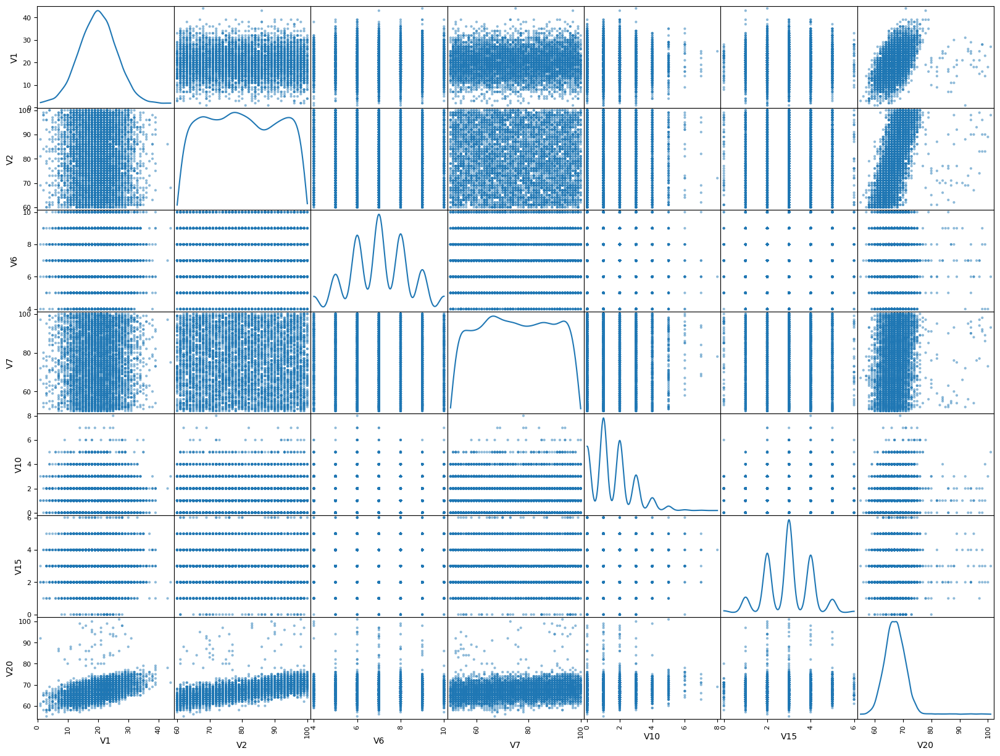

In [108]:
pd.plotting.scatter_matrix(data.loc[:, "V1":"V20"], diagonal="kde",figsize=(20,15))
plt.show()

In [109]:
ax = data[["V1","V2","V3","V4","V5","V6","V7","V8","V9","V10","V11","V12","V13","V14","V15","V16","V17","V18","V19","V19","V20"]].plot(figsize=(200,60))
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5));

<Figure size 800x600 with 0 Axes>

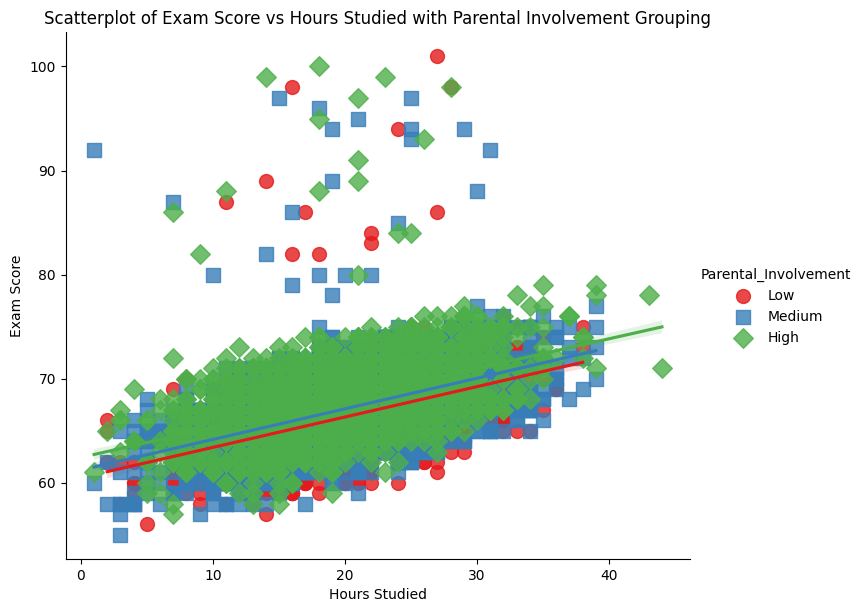

In [110]:
#  Scatterplot with Regression Line: Multivariate scatterplot of two numerical variables with categorical grouping
plt.figure(figsize=(8, 6))
sns.lmplot(data=df, x='Hours_Studied', y='Exam_Score', hue='Parental_Involvement', palette='Set1', height=6, aspect=1.2, markers=['o', 's', 'D'], scatter_kws={'s': 100}, fit_reg=True)
plt.title('Scatterplot of Exam Score vs Hours Studied with Parental Involvement Grouping')
plt.xlabel('Hours Studied')
plt.ylabel('Exam Score')
plt.show()

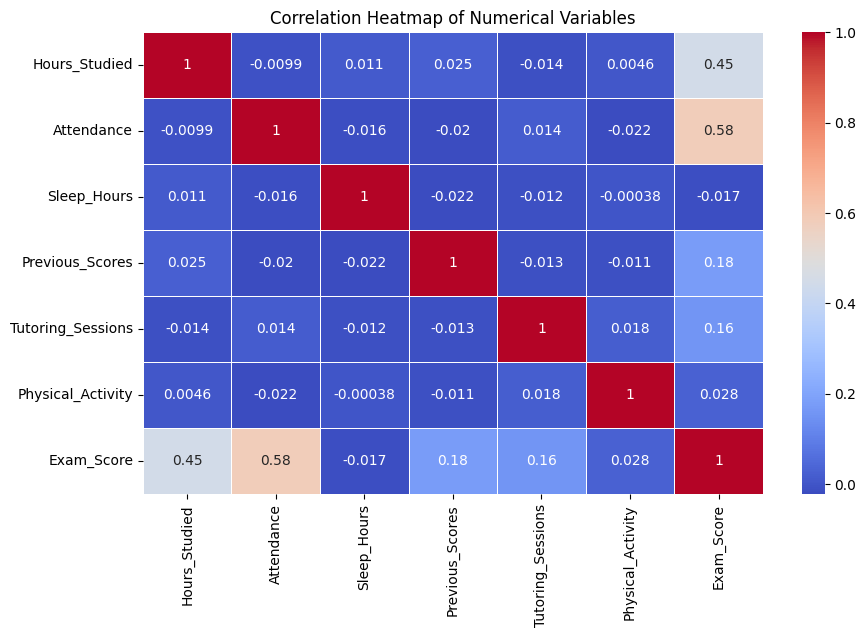

In [111]:
# ---------------------------- Correlation Heatmap for Numerical Variables ----------------------------

# Select only the numerical columns (filter out non-numeric columns)
numerical_df = df.select_dtypes(include=['float64', 'int64'])

# Compute the correlation matrix for the numerical columns
corr_matrix = numerical_df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()

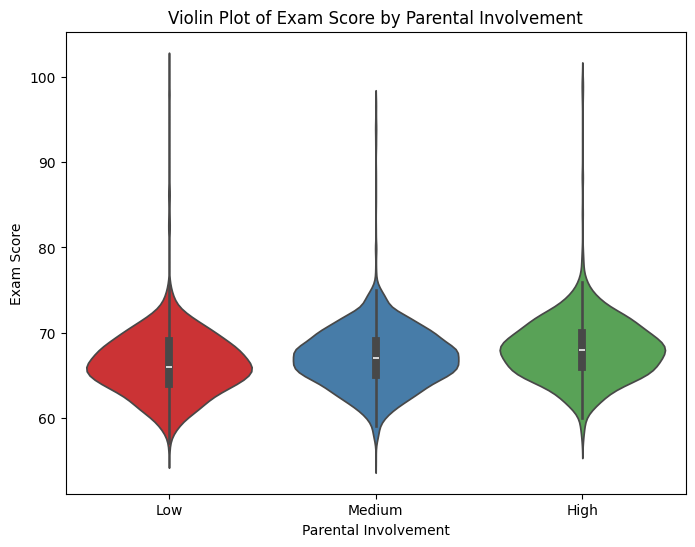

In [112]:
# 4. Violin Plot: Distribution of Exam Score across different Parental Involvement groups
plt.figure(figsize=(8, 6))
sns.violinplot(data=df, x='Parental_Involvement', y='Exam_Score', palette='Set1')
plt.title('Violin Plot of Exam Score by Parental Involvement')
plt.xlabel('Parental Involvement')
plt.ylabel('Exam Score')
plt.show()


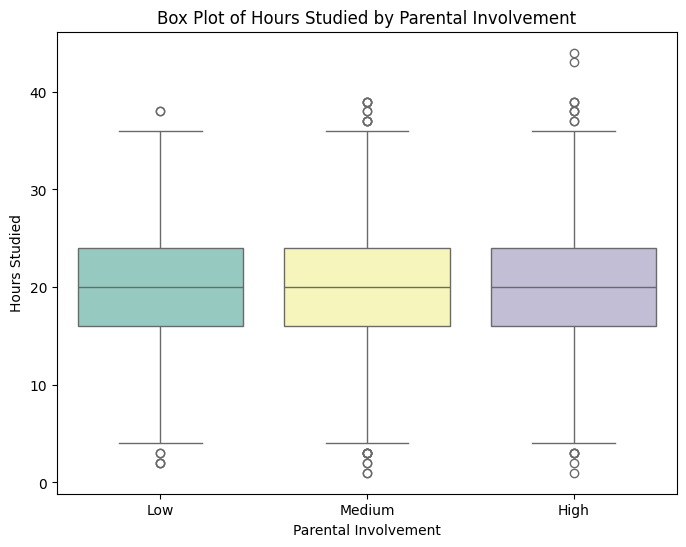

In [113]:
# 5. Box Plot: Distribution of Hours Studied across different Parental Involvement groups
plt.figure(figsize=(8, 6))
sns.boxplot(data=df, x='Parental_Involvement', y='Hours_Studied', palette='Set3')
plt.title('Box Plot of Hours Studied by Parental Involvement')
plt.xlabel('Parental Involvement')
plt.ylabel('Hours Studied')
plt.show()

Statistics summary

In [114]:
# 1. Descriptive statistics for all numerical columns
overall_summary = df.describe()
print("Overall Statistical Summary:")
print(overall_summary)

# 2. Grouping by a categorical variable and calculating summary statistics
grouped_summary = df.groupby('Parental_Involvement').describe()
print("\nStatistical Summary Grouped by 'Parental Involvement':")
print(grouped_summary)

Overall Statistical Summary:
       Hours_Studied   Attendance  Sleep_Hours  Previous_Scores  \
count    6607.000000  6607.000000   6607.00000      6607.000000   
mean       19.975329    79.977448      7.02906        75.070531   
std         5.990594    11.547475      1.46812        14.399784   
min         1.000000    60.000000      4.00000        50.000000   
25%        16.000000    70.000000      6.00000        63.000000   
50%        20.000000    80.000000      7.00000        75.000000   
75%        24.000000    90.000000      8.00000        88.000000   
max        44.000000   100.000000     10.00000       100.000000   

       Tutoring_Sessions  Physical_Activity   Exam_Score  
count        6607.000000        6607.000000  6607.000000  
mean            1.493719           2.967610    67.235659  
std             1.230570           1.031231     3.890456  
min             0.000000           0.000000    55.000000  
25%             1.000000           2.000000    65.000000  
50%          

In [115]:
# Specify the group variable
group_var = 'Parental_Involvement'  # Categorical variable for grouping

# Select only numerical columns
numerical_cols = df.select_dtypes(include=['number']).columns

# Check if there are numerical columns
if len(numerical_cols) > 0:
    # Calculate means per group for numerical variables
    means_per_group = df.groupby(group_var)[numerical_cols].mean()
    print("Means Per Group:")
    print(means_per_group)

    # Calculate variances per group for numerical variables
    variances_per_group = df.groupby(group_var)[numerical_cols].var()
    print("\nVariances Per Group:")
    print(variances_per_group)
else:
    print("No numerical columns found in the dataset.")

Means Per Group:
                      Hours_Studied  Attendance  Sleep_Hours  Previous_Scores  \
Parental_Involvement                                                            
High                      19.854822   79.948113     7.017820        74.753669   
Low                       20.134630   80.305161     7.053104        75.661182   
Medium                    19.980369   79.863772     7.025877        75.015467   

                      Tutoring_Sessions  Physical_Activity  Exam_Score  
Parental_Involvement                                                    
High                           1.501048           2.954927   68.092767  
Low                            1.513089           2.968586   66.358265  
Medium                         1.481856           2.974420   67.098156  

Variances Per Group:
                      Hours_Studied  Attendance  Sleep_Hours  Previous_Scores  \
Parental_Involvement                                                            
High                      37

In [116]:
def calcWithinGroupsVariance(variable, groupvariable):
    # find out how many values the group variable can take
    levels = sorted(set(groupvariable))
    numlevels = len(levels)
    # get the mean and standard deviation for each group:
    numtotal = 0
    denomtotal = 0
    for leveli in levels:
        levelidata = variable[groupvariable==leveli]
        levelilength = len(levelidata)
        # get the standard deviation for group i:
        sdi = np.std(levelidata)
        numi = (levelilength)*sdi**2
        denomi = levelilength
        numtotal = numtotal + numi
        denomtotal = denomtotal + denomi
    # calculate the within-groups variance
    Vw = numtotal / (denomtotal - numlevels)
    return Vw

In [117]:
calcWithinGroupsVariance(X.V2, y)

133.22221025488213

In [118]:
def calcBetweenGroupsVariance(variable, groupvariable):
    # find out how many values the group variable can take
    levels = sorted(set((groupvariable)))
    numlevels = len(levels)
    # calculate the overall grand mean:
    grandmean = np.mean(variable)
    # get the mean and standard deviation for each group:
    numtotal = 0
    denomtotal = 0
    for leveli in levels:
        levelidata = variable[groupvariable==leveli]
        levelilength = len(levelidata)
        # get the mean and standard deviation for group i:
        meani = np.mean(levelidata)
        sdi = np.std(levelidata)
        numi = levelilength * ((meani - grandmean)**2)
        denomi = levelilength
        numtotal = numtotal + numi
        denomtotal = denomtotal + denomi
    # calculate the between-groups variance
    Vb = numtotal / (numlevels - 1)
    return(Vb)

In [119]:
calcBetweenGroupsVariance(X.V2, y)

153.3651810609759

In [120]:
# Group by 'Gender'
grouped_df = df.groupby('Gender')

# Select the numerical columns for analysis
variable_x = 'Hours_Studied'
variable_y = 'Exam_Score'

# 1. Compute within-groups covariance for each gender
within_group_covariances = {}
for name, group in grouped_df:
    cov_matrix = group[[variable_x, variable_y]].cov()
    within_group_covariances[name] = cov_matrix
    print(f"Within-group covariance for {name}:")
    print(cov_matrix)
    print("\n")

# 2. Compute between-groups covariance
# Calculate group means and overall mean
group_means = grouped_df[[variable_x, variable_y]].mean()
overall_mean = df[[variable_x, variable_y]].mean()

# Calculate the between-groups covariance matrix
n_groups = len(group_means)
between_group_cov_matrix = (group_means - overall_mean).cov() * n_groups

print("Between-groups covariance matrix:")
print(between_group_cov_matrix)

Within-group covariance for Female:
               Hours_Studied  Exam_Score
Hours_Studied      35.967024   10.618758
Exam_Score         10.618758   16.438571


Within-group covariance for Male:
               Hours_Studied  Exam_Score
Hours_Studied       35.83708   10.210730
Exam_Score          10.21073   14.185464


Between-groups covariance matrix:
               Hours_Studied  Exam_Score
Hours_Studied       0.002644    0.000823
Exam_Score          0.000823    0.000256


In [121]:
from scipy.stats import pearsonr

In [122]:
# Select numerical columns
numerical_columns = ['Hours_Studied', 'Attendance', 'Sleep_Hours', 'Previous_Scores',
                     'Tutoring_Sessions', 'Physical_Activity', 'Exam_Score']

# Calculate the Pearson correlation coefficient for each pair of numerical variables
pearson_results = {}
for i in range(len(numerical_columns)):
    for j in range(i + 1, len(numerical_columns)):
        var1 = numerical_columns[i]
        var2 = numerical_columns[j]
        # Calculate Pearson correlation and p-value
        corr, p_value = pearsonr(df[var1], df[var2])
        pearson_results[f"{var1} vs {var2}"] = {'Correlation': corr, 'p-value': p_value}

# Display the results
for pair, stats in pearson_results.items():
    print(f"Pearson Correlation for {pair}: {stats['Correlation']:.3f}, p-value: {stats['p-value']:.3f}")

Pearson Correlation for Hours_Studied vs Attendance: -0.010, p-value: 0.421
Pearson Correlation for Hours_Studied vs Sleep_Hours: 0.011, p-value: 0.372
Pearson Correlation for Hours_Studied vs Previous_Scores: 0.025, p-value: 0.043
Pearson Correlation for Hours_Studied vs Tutoring_Sessions: -0.014, p-value: 0.246
Pearson Correlation for Hours_Studied vs Physical_Activity: 0.005, p-value: 0.707
Pearson Correlation for Hours_Studied vs Exam_Score: 0.445, p-value: 0.000
Pearson Correlation for Attendance vs Sleep_Hours: -0.016, p-value: 0.196
Pearson Correlation for Attendance vs Previous_Scores: -0.020, p-value: 0.101
Pearson Correlation for Attendance vs Tutoring_Sessions: 0.014, p-value: 0.244
Pearson Correlation for Attendance vs Physical_Activity: -0.022, p-value: 0.068
Pearson Correlation for Attendance vs Exam_Score: 0.581, p-value: 0.000
Pearson Correlation for Sleep_Hours vs Previous_Scores: -0.022, p-value: 0.077
Pearson Correlation for Sleep_Hours vs Tutoring_Sessions: -0.012, 

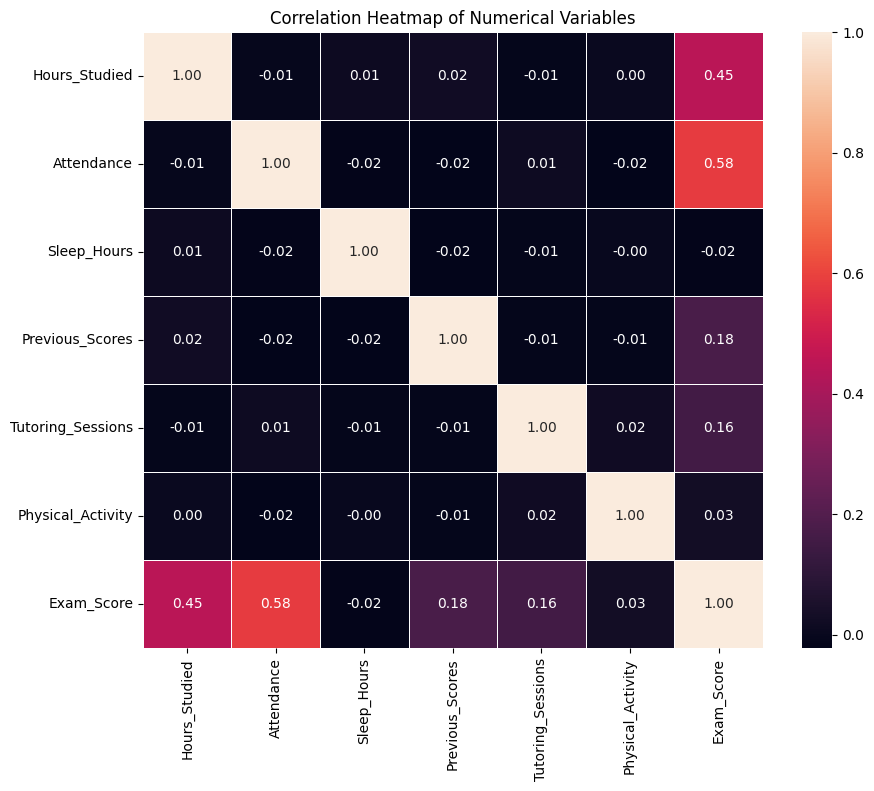

In [123]:
# Step 3: Define numerical columns
numerical_columns = ['Hours_Studied', 'Attendance', 'Sleep_Hours', 'Previous_Scores',
                     'Tutoring_Sessions', 'Physical_Activity', 'Exam_Score']

# Step 4: Calculate the correlation matrix
corr_matrix = df[numerical_columns].corr()

# Step 5: Create the heatmap
plt.figure(figsize=(10, 8))  # Adjust the size as necessary
sns.heatmap(corr_matrix, annot=True, fmt=".2f", linewidths=0.5)

# Step 6: Customize the plot
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()

In [124]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [125]:
# Step 4: Initialize the StandardScaler
scaler = StandardScaler()

# Step 5: Fit and transform the selected columns
df_standardized = df.copy()  # Make a copy of the original DataFrame
df_standardized[numerical_columns] = scaler.fit_transform(df[numerical_columns])

# Display the first few rows of the standardized DataFrame
print(df_standardized.head())

   Hours_Studied  Attendance Parental_Involvement Access_to_Resources  \
0       0.504942    0.348375                  Low                High   
1      -0.162822   -1.383736                  Low              Medium   
2       0.671882    1.560853               Medium              Medium   
3       1.506587    0.781403                  Low              Medium   
4      -0.162822    1.041220               Medium              Medium   

  Extracurricular_Activities  Sleep_Hours  Previous_Scores Motivation_Level  \
0                         No    -0.019796        -0.143800              Low   
1                         No     0.661399        -1.116110              Low   
2                        Yes    -0.019796         1.106313           Medium   
3                        Yes     0.661399         1.592469           Medium   
4                        Yes    -0.700990        -0.699406           Medium   

  Internet_Access  Tutoring_Sessions Family_Income Teacher_Quality  \
0             Ye

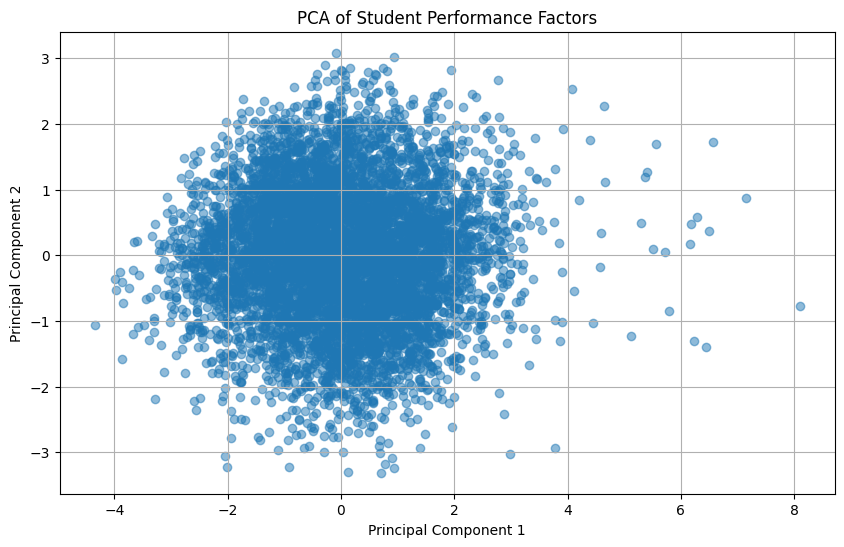

Explained Variance Ratio: [0.25214912 0.1499744 ]


In [126]:
scaler = StandardScaler()
df_standardized = scaler.fit_transform(df[numerical_columns])

# Step 5: Apply PCA
pca = PCA(n_components=2)  # Number of components you want to keep
principal_components = pca.fit_transform(df_standardized)

# Step 6: Create a DataFrame with the PCA results
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])

# Optional: Add labels to the PCA DataFrame if needed
# pca_df['Label'] = df['SomeCategoricalVariable']

# Step 7: Visualize the PCA results
plt.figure(figsize=(10, 6))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.5)  # Scatter plot
plt.title('PCA of Student Performance Factors')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid()
plt.show()

# Step 8: Explained Variance Ratio
explained_variance = pca.explained_variance_ratio_
print(f'Explained Variance Ratio: {explained_variance}')